<a href="https://colab.research.google.com/github/Roopesh-DMahanthi/StumbleUpon-Evergreen-Classification-Challenge/blob/main/stumbleupon_distilbert_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Importing basic dependencies and Dataset

In [55]:
import pandas as pd 
import numpy as np 

import matplotlib.pyplot as plt 
import seaborn as sns 
%matplotlib inline 

import tensorflow as tf 

In [56]:
df_train=pd.read_csv('https://github.com/Roopesh-DMahanthi/StumbleUpon-Evergreen-Classification-Challenge/raw/main/train.tsv',sep='\t')

df_test=pd.read_csv('https://github.com/Roopesh-DMahanthi/StumbleUpon-Evergreen-Classification-Challenge/raw/main/test.tsv',sep='\t',usecols=['urlid','boilerplate'])

In [57]:
df_train.head(50)

,url,urlid,boilerplate,alchemy_category,alchemy_category_score,avglinksize,commonlinkratio_1,commonlinkratio_2,commonlinkratio_3,commonlinkratio_4,compression_ratio,embed_ratio,framebased,frameTagRatio,hasDomainLink,html_ratio,image_ratio,is_news,lengthyLinkDomain,linkwordscore,news_front_page,non_markup_alphanum_characters,numberOfLinks,numwords_in_url,parametrizedLinkRatio,spelling_errors_ratio,label
0,http://www.bloomberg.com/news/2010-12-23/ibm-p...,4042,"{""title"":""IBM Sees Holographic Calls Air Breat...",business,0.789131,2.055556,0.676471,0.205882,0.047059,0.023529,0.443783,0.000000,0,0.090774,0,0.245831,0.003883,1,1,24,0,5424,170,8,0.152941,0.079130,0
1,http://www.popsci.com/technology/article/2012-...,8471,"{""title"":""The Fully Electronic Futuristic Star...",recreation,0.574147,3.677966,0.508021,0.288770,0.213904,0.144385,0.468649,0.000000,0,0.098707,0,0.203490,0.088652,1,1,40,0,4973,187,9,0.181818,0.125448,1
2,http://www.menshealth.com/health/flu-fighting-...,1164,"{""title"":""Fruits that Fight the Flu fruits tha...",health,0.996526,2.382883,0.562016,0.321705,0.120155,0.042636,0.525448,0.000000,0,0.072448,0,0.226402,0.120536,1,1,55,0,2240,258,11,0.166667,0.057613,1
3,http://www.dumblittleman.com/2007/12/10-foolpr...,6684,"{""title"":""10 Foolproof Tips for Better Sleep ""...",health,0.801248,1.543103,0.400000,0.100000,0.016667,0.000000,0.480725,0.000000,0,0.095861,0,0.265656,0.035343,1,0,24,0,2737,120,5,0.041667,0.100858,1
4,http://bleacherreport.com/articles/1205138-the...,9006,"{""title"":""The 50 Coolest Jerseys You Didn t Kn...",sports,0.719157,2.676471,0.500000,0.222222,0.123457,0.043210,0.446143,0.000000,0,0.024908,0,0.228887,0.050473,1,1,14,0,12032,162,10,0.098765,0.082569,0
5,http://www.conveniencemedical.com/genital-herp...,7018,"{""url"":""conveniencemedical genital herpes home...",?,?,119.000000,0.745455,0.581818,0.290909,0.018182,0.434639,0.000000,0,0.019841,0,0.298300,0.038636,?,0,12,?,4368,55,3,0.054545,0.087356,0
6,http://gofashionlane.blogspot.tw/2012/06/ameri...,8685,"{""title"":""fashion lane American Wild Child "",""...",arts_entertainment,0.22111,0.773810,0.215054,0.053763,0.043011,0.043011,0.579596,0.000000,0,0.039568,0,0.218978,0.311377,1,0,21,0,1287,93,3,0.548387,0.064327,1
7,http://www.insidershealth.com/article/racing_f...,3402,"{""url"":""insidershealth article racing for reco...",?,?,1.883333,0.719697,0.265152,0.113636,0.015152,0.499348,0.000000,0,0.026616,0,0.173746,0.025830,?,0,5,?,27656,132,4,0.068182,0.148551,0
8,http://www.valetmag.com/the-handbook/features/...,477,"{""title"":""Valet The Handbook 31 Days 31 days"",...",?,?,0.471503,0.190722,0.036082,0.000000,0.000000,0.383199,0.000000,0,0.021705,0,0.114962,1.136646,1,0,17,0,2471,194,7,0.644330,0.125000,1
9,http://www.howsweeteats.com/2010/03/24/cookies...,6731,"{""url"":""howsweeteats 2010 03 24 cookies and cr...",?,?,2.410112,0.469325,0.101227,0.018405,0.003067,0.465859,0.000000,0,0.012000,0,0.205117,0.206262,?,1,14,?,11459,326,4,0.236196,0.094412,1


In [ ]:
df_train.shape

(7395, 27)

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7395 entries, 0 to 7394
Data columns (total 27 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   url                             7395 non-null   object 
 1   urlid                           7395 non-null   int64  
 2   boilerplate                     7395 non-null   object 
 3   alchemy_category                5053 non-null   object 
 4   alchemy_category_score          5053 non-null   object 
 5   avglinksize                     7395 non-null   float64
 6   commonlinkratio_1               7395 non-null   float64
 7   commonlinkratio_2               7395 non-null   float64
 8   commonlinkratio_3               7395 non-null   float64
 9   commonlinkratio_4               7395 non-null   float64
 10  compression_ratio               7395 non-null   float64
 11  embed_ratio                     7395 non-null   float64
 12  framebased                      73

## Dealing with NULL and Missing values

In [ ]:
null_columns=df_train.columns[df_train.isnull().any()]
df_train[null_columns].isnull().sum()

alchemy_category          2342
alchemy_category_score    2342
is_news                   2843
news_front_page           1248
dtype: int64

In [ ]:
df_train.replace('?',np.NaN,inplace=True)

In [ ]:
for col in df_train.columns:
  print(df_train[col].value_counts())
  print()

http://www.geekarmy.com/funny/Wrong-Ball-Coach.html                                                                       1
http://www.nbcnews.com/                                                                                                   1
http://www.whattoexpect.com/preconception/health-and-wellness/safeguard-your-health/know-your-medications.aspx?xid=SU_    1
http://socoting.com/now-to-go-find-a-scientist/                                                                           1
http://www.theheart.org/article/1110201.do                                                                                1
                                                                                                                         ..
http://www.peta.org/living/vegetarian-living/creamy-raspberry-orange-popsicles.aspx?c=pfs                                 1
http://www.epicurious.com/articlesguides/bestof/toprecipes/bestbaconrecipes                                               1
http://s

## Visualising Dataset for any patterns

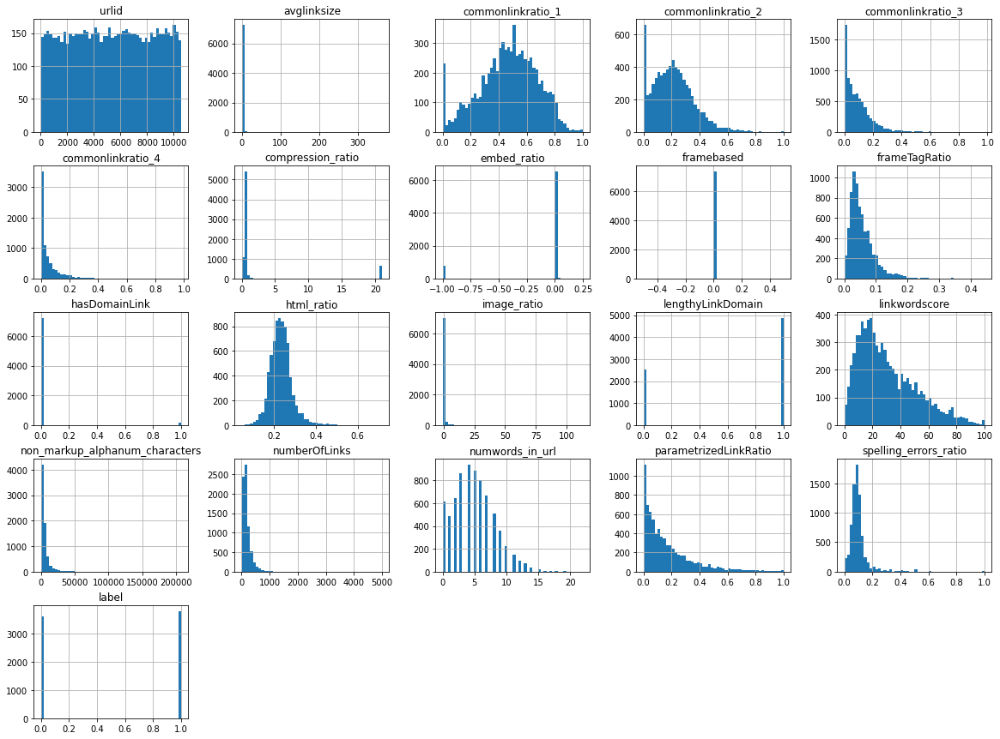

In [ ]:
df_train.hist(bins=50,figsize=(20,15))
plt.show()

In [ ]:
corr_matrix = df_train.corr()

In [ ]:
corr_matrix

,urlid,avglinksize,commonlinkratio_1,commonlinkratio_2,commonlinkratio_3,commonlinkratio_4,compression_ratio,embed_ratio,framebased,frameTagRatio,hasDomainLink,html_ratio,image_ratio,lengthyLinkDomain,linkwordscore,non_markup_alphanum_characters,numberOfLinks,numwords_in_url,parametrizedLinkRatio,spelling_errors_ratio,label
urlid,1.000000,-0.011162,0.002856,0.008407,0.005285,0.009573,-0.007343,0.013340,NaN,0.010065,-0.005802,0.016989,-0.000590,-0.007780,-0.013668,0.016732,-0.002019,-0.017342,-0.005868,0.002292,0.013450
avglinksize,-0.011162,1.000000,0.120467,0.161769,0.174554,0.134527,-0.003578,0.005254,NaN,-0.049270,-0.002046,0.018974,-0.003002,0.020852,0.122550,-0.010982,0.000360,-0.033890,0.006089,0.035393,0.006172
commonlinkratio_1,0.002856,0.120467,1.000000,0.808047,0.560584,0.388801,-0.017878,0.005280,NaN,-0.294860,0.006790,-0.201501,-0.064435,0.421284,0.257200,0.193914,0.317293,0.144354,-0.078026,-0.035019,0.083364
commonlinkratio_2,0.008407,0.161769,0.808047,1.000000,0.758330,0.555148,-0.032460,0.019387,NaN,-0.259222,0.000263,-0.159702,-0.044663,0.398817,0.257594,0.177785,0.311492,0.096940,-0.079485,-0.027888,0.083488
commonlinkratio_3,0.005285,0.174554,0.560584,0.758330,1.000000,0.850604,-0.016188,0.007578,NaN,-0.218559,-0.031097,-0.133370,-0.050357,0.363159,0.109654,0.264022,0.283924,0.049203,-0.008652,-0.008599,0.105964
commonlinkratio_4,0.009573,0.134527,0.388801,0.555148,0.850604,1.000000,-0.020415,0.005473,NaN,-0.178064,-0.052519,-0.136561,-0.038071,0.287159,0.059223,0.162883,0.233898,0.026384,0.036387,-0.013507,0.080464
compression_ratio,-0.007343,-0.003578,-0.017878,-0.032460,-0.016188,-0.020415,1.000000,-0.889345,NaN,0.159335,0.027657,0.106335,-0.188976,-0.090325,0.146470,-0.064163,-0.055388,-0.042614,-0.033772,0.364122,-0.059737
embed_ratio,0.013340,0.005254,0.005280,0.019387,0.007578,0.005473,-0.889345,1.000000,NaN,-0.130753,-0.026473,-0.090938,0.183808,0.075322,-0.108476,0.046484,0.042942,0.043343,0.037361,-0.342206,0.039536
framebased,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
frameTagRatio,0.010065,-0.049270,-0.294860,-0.259222,-0.218559,-0.178064,0.159335,-0.130753,NaN,1.000000,0.010193,0.384937,-0.088847,-0.196673,0.158874,-0.303682,-0.362491,0.049330,-0.094557,0.033663,-0.187762


In [ ]:
corr_matrix["label"].sort_values(ascending=False)

label                             1.000000
commonlinkratio_3                 0.105964
non_markup_alphanum_characters    0.097580
commonlinkratio_2                 0.083488
commonlinkratio_1                 0.083364
commonlinkratio_4                 0.080464
numberOfLinks                     0.080187
embed_ratio                       0.039536
lengthyLinkDomain                 0.032824
urlid                             0.013450
parametrizedLinkRatio             0.010668
avglinksize                       0.006172
hasDomainLink                    -0.004863
image_ratio                      -0.017266
numwords_in_url                  -0.024823
html_ratio                       -0.051149
spelling_errors_ratio            -0.058578
compression_ratio                -0.059737
linkwordscore                    -0.173800
frameTagRatio                    -0.187762
framebased                             NaN
Name: label, dtype: float64

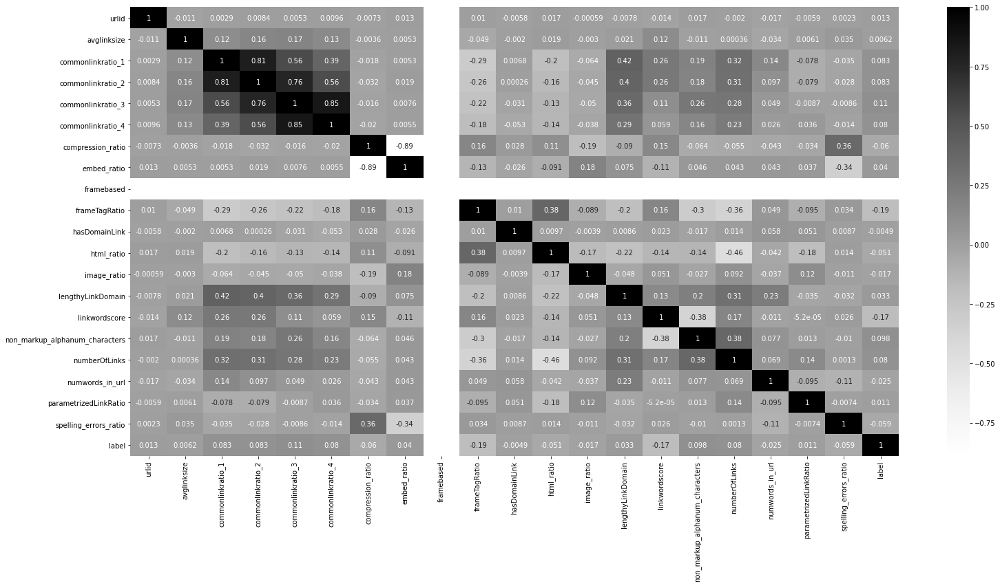

In [ ]:
plt.figure(figsize=(25, 12))
sns.heatmap(corr_matrix,cmap='Greys',annot=True)

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/misc.py:80: UserWarning: Attempting to set identical left == right == 0.0 results in singular transformations; automatically expanding.
  ax.set_xlim(boundaries_list[j])
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/misc.py:81: UserWarning: Attempting to set identical bottom == top == 0.0 results in singular transformations; automatically expanding.
  ax.set_ylim(boundaries_list[i])
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/misc.py:71: UserWarning: Attempting to set identical left == right == 0.0 results in singular transformations; automatically expanding.
  ax.set_xlim(boundaries_list[i])


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f84ebf6bb10>,
      dtype=object)

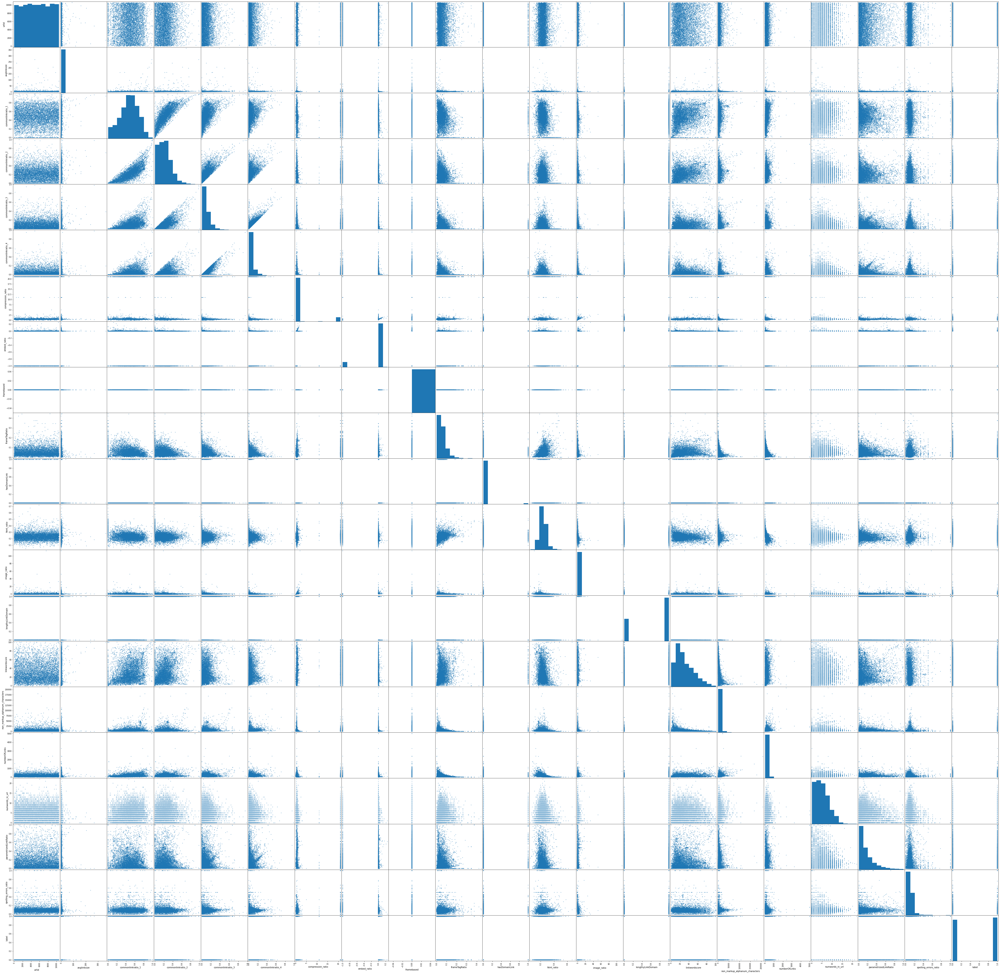

In [ ]:
from pandas.plotting import scatter_matrix

attributes = df_train.columns
scatter_matrix(df_train[attributes],figsize=(80,80))

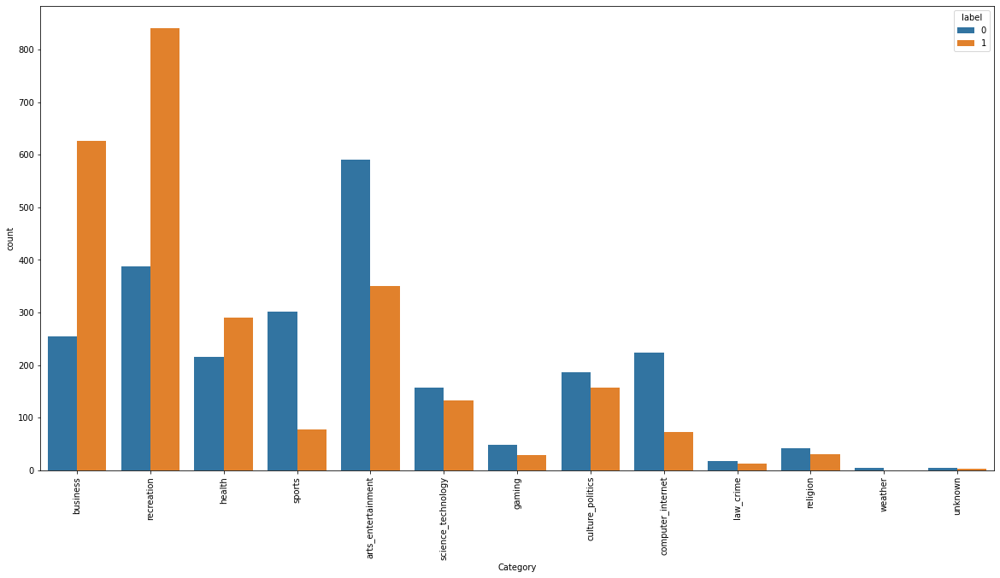

In [ ]:
plt.figure(figsize=(20,10))
sns.countplot(x=df_train['alchemy_category'],hue=df_train['label']);
plt.xlabel('Category');
plt.xticks(rotation=90);

In [ ]:
df_train['alchemy_category'].value_counts()

recreation            1229
arts_entertainment     941
business               880
health                 506
sports                 380
culture_politics       343
computer_internet      296
science_technology     289
gaming                  76
religion                72
law_crime               31
unknown                  6
weather                  4
Name: alchemy_category, dtype: int64

# Text Data Processing

In [58]:
df_train['boilerplate'].replace(to_replace=r'"title":', value="",inplace=True,regex=True)
df_train['boilerplate'].replace(to_replace=r'"body":', value="",inplace=True,regex=True)
df_train['boilerplate'].replace(to_replace=r'"url":',value="",inplace=True,regex=True)

df_train['boilerplate'].replace(to_replace=r'{|}',value="",inplace=True,regex=True)
df_train['boilerplate']=df_train['boilerplate'].str.lower()
 

df_test['boilerplate'].replace(to_replace=r'"title":', value="",inplace=True,regex=True)
df_test['boilerplate'].replace(to_replace=r'"body":', value="",inplace=True,regex=True)
df_test['boilerplate'].replace(to_replace=r'"url":',value="",inplace=True,regex=True)

df_test['boilerplate'].replace(to_replace=r'{|}',value="",inplace=True,regex=True)
df_test['boilerplate']=df_test['boilerplate'].str.lower()


In [62]:
import nltk
nltk.download('stopwords')
nltk.download('punkt')
def filter_stopwords(sentence):
  from nltk.corpus import stopwords 
  from nltk.tokenize import word_tokenize 

  stop_words = set(stopwords.words('english')) 

  word_tokens = word_tokenize(sentence) 

  filtered_sentence = [w for w in word_tokens if not(w in stop_words) and w !='``' ]  

  return (' ').join(filtered_sentence)


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [64]:
df_train['boilerplate']=df_train['boilerplate'].apply(filter_stopwords)
df_test['boilerplate']=df_test['boilerplate'].apply(filter_stopwords)

In [7]:
!pip install transformers

     |████████████████████████████████| 1.9MB 18.6MB/s 
     |████████████████████████████████| 890kB 55.7MB/s 
     |████████████████████████████████| 3.2MB 50.2MB/s 
  Created wheel for sacremoses: filename=sacremoses-0.0.43-cp37-none-any.whl size=893262 sha256=c4be7048c4a2f9120f4071685331487a4af925eb1cd394367fd531b638357b98
  Stored in directory: /root/.cache/pip/wheels/29/3c/fd/7ce5c3f0666dab31a50123635e6fb5e19ceb42ce38d4e58f45
Successfully built sacremoses


In [65]:
from transformers import TFDistilBertModel, DistilBertTokenizer, TFDistilBertForSequenceClassification
distil_bert = 'distilbert-base-uncased'

#Dataset Preparation

In [66]:
df_train["label"].value_counts() / len(df_train)

1    0.51332
0    0.48668
Name: label, dtype: float64

In [67]:
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.15, random_state=42)
for train_index, test_index in split.split(df_train,df_train["label"]):
  strat_train_set = df_train.loc[train_index]
  strat_val_set = df_train.loc[test_index]

print(strat_train_set["label"].value_counts() / len(strat_train_set))
print(len(strat_train_set))
print(strat_val_set["label"].value_counts() / len(strat_val_set))
print(len(strat_val_set))

1    0.513286
0    0.486714
Name: label, dtype: float64
6285
1    0.513514
0    0.486486
Name: label, dtype: float64
1110


In [68]:
strat_train_set = strat_train_set.reset_index(drop=True)
strat_val_set = strat_val_set.reset_index(drop=True)

In [69]:
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_encodings = tokenizer(strat_train_set['boilerplate'].to_list(), truncation=True, padding=True)
val_encodings = tokenizer(strat_val_set['boilerplate'].to_list(), truncation=True, padding=True)

In [72]:
strat_train_set['boilerplate'][0]

"caffeine actually brain caffeine actually brain '' , '' wild popularity caffeine one seriously misunderstood substance simple upper works differently different people different tolerances even different menstrual cycles make work better photo rbrwr covered kinds caffeine hacks lifehacker taking caffeine naps getting optimally wired course obsessed perfect cup coffee comes many us love coffee tea soda energy drink fixes actually busy brains never really dug whole lot one read caffeine falls realm highly specific medical research often conflicting anecdotal evidence luckily one intrepid reader writer actually done reading weighed evidence put together highly readable treatise subject buzz science lore alcohol caffeine stephen r braun well worth short 224 page read released 1997 remains accessible treatise understood caffeine alcohol brain social history coffee lecture evils mass market soda condensed clean science follows brief explainer caffeine affects productivity drawn buzz sources 

In [70]:
tokenizer.decode(train_encodings['input_ids'][0])

"[CLS] caffeine actually brain caffeine actually brain'','' wild popularity caffeine one seriously misunderstood substance simple upper works differently different people different tolerances even different menstrual cycles make work better photo rbrwr covered kinds caffeine hacks lifehacker taking caffeine naps getting optimally wired course obsessed perfect cup coffee comes many us love coffee tea soda energy drink fixes actually busy brains never really dug whole lot one read caffeine falls realm highly specific medical research often conflicting anecdotal evidence luckily one intrepid reader writer actually done reading weighed evidence put together highly readable treatise subject buzz science lore alcohol caffeine stephen r braun well worth short 224 page read released 1997 remains accessible treatise understood caffeine alcohol brain social history coffee lecture evils mass market soda condensed clean science follows brief explainer caffeine affects productivity drawn buzz sourc

In [99]:
len(dict(train_encodings)['input_ids'])

6285

In [73]:
train=tf.data.Dataset.from_tensor_slices((
    dict(train_encodings),
    strat_train_set['label']
))
val=tf.data.Dataset.from_tensor_slices((
    dict(val_encodings),
    strat_val_set['label']
))

#Model Training and Evaluation

In [75]:
model = TFDistilBertForSequenceClassification.from_pretrained(distil_bert,num_labels=2)

Some layers from the model checkpoint at distilbert-base-uncased were not used when initializing TFDistilBertForSequenceClassification: ['vocab_transform', 'vocab_layer_norm', 'activation_13', 'vocab_projector']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some layers of TFDistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier', 'pre_classifier', 'dropout_19']
You should probably TRAIN this model on a down-stream task to be able to use i

In [76]:
model.summary()

Model: "tf_distil_bert_for_sequence_classification"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
distilbert (TFDistilBertMain multiple                  66362880  
_________________________________________________________________
pre_classifier (Dense)       multiple                  590592    
_________________________________________________________________
classifier (Dense)           multiple                  1538      
_________________________________________________________________
dropout_19 (Dropout)         multiple                  0         
Total params: 66,955,010
Trainable params: 66,955,010
Non-trainable params: 0
_________________________________________________________________


In [77]:
%load_ext tensorboard

In [78]:
import datetime, os
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [79]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [80]:
class myCB(tf.keras.callbacks.Callback):
  def __init__(self,patience=0):
    self.patience=10
    self.best_weights=None
    self.wait = 0
    self.stopped_epoch = 0
    self.best = np.Inf
  def on_epoch_end(self,epoch,logs={}):
    if(logs.get('accuracy')>=0.99):
      print("/nReached 99% Accuracy....Stopping Further Training")
      self.model.stop_training=True
    current = logs.get('loss')
    if np.less(current, self.best):
      self.best = current
      self.wait = 0
      self.best_weights = self.model.get_weights()
    else:
      self.wait += 1
      if self.wait >= self.patience:
        self.stopped_epoch = epoch
        self.model.stop_training = True
        print('Restoring model weights from the end of the best epoch.')
        self.model.set_weights(self.best_weights)

cb=myCB()

In [81]:
optimizer = tf.keras.optimizers.Adam(learning_rate=5e-5)
model.compile(optimizer=optimizer, loss=model.compute_loss, metrics=['accuracy'])
history = model.fit(train.shuffle(100).batch(16),
          epochs=10,
          batch_size=16,
          validation_data=val.shuffle(100).batch(16),callbacks=[tensorboard_callback,cb])

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module, class, method, function, traceback, frame, or code object was expected, got cython_function_or_method
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module, class, method, function, traceback, frame, or code object was expected, got cython_function_or_method
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: while/else statement not yet supported
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: while/else statement not yet supported
To silence this warning, decorate the function with @tf.autog

In [82]:
model.save_pretrained("/tmp/custom_model")

In [83]:
model.save_pretrained("trained_model")

In [85]:
!ls -la trained_model/

total 261688
drwxr-xr-x 2 root root      4096 Feb 28 07:12 .
drwxr-xr-x 1 root root      4096 Feb 28 07:12 ..
-rw-r--r-- 1 root root       523 Feb 28 07:12 config.json
-rw-r--r-- 1 root root 267952512 Feb 28 07:12 tf_model.h5


In [ ]:
loaded_model = TFDistilBertForSequenceClassification.from_pretrained("/tmp/custom_model")

Some weights of the model checkpoint at /tmp/sentiment_custom_model were not used when initializing TFDistilBertForSequenceClassification: ['dropout_19']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPretraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of TFDistilBertForSequenceClassification were not initialized from the model checkpoint at /tmp/sentiment_custom_model and are newly initialized: ['dropout_39']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


# Model Prediction

In [90]:
predict_input = tokenizer.encode(df_train['boilerplate'][1],
                                 truncation=True,
                                 padding=True,
                                 return_tensors="tf")

tf_output = model.predict(predict_input)[0]
print(tf_output)

[[-3.1407883  3.0344908]]


In [91]:
tf_prediction = tf.nn.softmax(tf_output, axis=1).numpy()[0]
print(tf_prediction)
print(tf_prediction.argmax())
# 9.9978644e-01 = 0.99978644
# 2.1356659e-04 = 0.00021356659
# => sentiment = 0

[0.00207591 0.9979241 ]
1


#Preparing Submission Dataset

In [96]:
df_test

,urlid,boilerplate,label
0,5865,homemade enchilada sauce lynn kitchen adventur...,1
1,782,"lolpics stun grenade ar , '' funny pictures lo...",0
2,6962,"treadmills , '' treadmills , stair , climbers ...",0
3,7640,father tactics used assad crush revolt threate...,0
4,3589,stem turns lemons limes juicy atomizers gadget...,0
...,...,...,...
3166,7264,"peep brownie mores busy mommy iowa mom blog , ...",1
3167,9714,"cannabissearch edibles cheesecake '' , '' mari...",1
3168,5903,viewed submissions time viewed submissions tim...,1
3169,3176,get complete workout nothing body get complete...,1


In [93]:
test_label = []

In [94]:
for i,sentence in enumerate(df_test['boilerplate']):
  predict_input = tokenizer.encode(sentence,
                                 truncation=True,
                                 padding=True,
                                 return_tensors="tf")

  tf_output = model.predict(predict_input)[0]
  tf_prediction = tf.nn.softmax(tf_output, axis=1).numpy()[0]
  test_label.append(tf_prediction.argmax())

In [95]:
df_test['label']=test_label

In [97]:
df_test.to_csv('submisssion.tsv',sep='\t')